# Variational Autoencoder (VAE)

## Encoder and Decoder


In [ ]:
import torch.nn as nn
from torch.utils.data.dataloader import DataLoader
from torchvision import datasets, transforms
from torch.distributions.normal import Normal
from torch.distributions.kl import kl_divergence
import matplotlib.pyplot as plt
from torchvision.utils import make_grid
from tqdm import tqdm
import time


In [ ]:
def show_tensor_images(image_tensor, num_images=25, size=(3, 256, 256)):
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.axis('off')
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())

In [7]:

class Encoder(nn.Module):
    def __init__(self, im_chan=3, output_chan=512, hidden_dim=16):
        super(Encoder, self).__init__()
        self.z_dim = output_chan
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, hidden_dim * 4),
            self.make_disc_block(hidden_dim * 4, output_chan * 2, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride, padding=1),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride, padding=1),
            )

    def forward(self, image):
        disc_pred = self.disc(image)
        encoding = disc_pred.view(len(disc_pred), -1)
        return encoding[:, :self.z_dim], encoding[:, self.z_dim:2*self.z_dim].exp()
class Decoder(nn.Module):    
    def __init__(self, z_dim=512, im_chan=3, hidden_dim=64):
        super(Decoder, self).__init__()
        self.z_dim = z_dim
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 8, kernel_size=4, stride=2),
            self.make_gen_block(hidden_dim * 8, hidden_dim * 4, kernel_size=4, stride=2),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=3),
            self.make_gen_block(hidden_dim * 2, hidden_dim, kernel_size=4, stride=2),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, stride=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):

        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Sigmoid(),
            )

    def forward(self, noise):
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

In [8]:
class VAE(nn.Module):
    
    def __init__(self, z_dim=128, im_chan=3, hidden_dim=64):
        super(VAE, self).__init__()
        self.z_dim = z_dim
        self.encode = Encoder(im_chan, z_dim)
        self.decode = Decoder(z_dim, im_chan)

    def forward(self, images):

        q_mean, q_stddev = self.encode(images)
        q_dist = Normal(q_mean, q_stddev)
        z_sample = q_dist.rsample() 
        decoding = self.decode(z_sample)
        return decoding, q_dist

In [9]:
reconstruction_loss = nn.BCELoss(reduction='sum')

In [10]:
def kl_divergence_loss(q_dist):
    return kl_divergence(
        q_dist, Normal(torch.zeros_like(q_dist.mean), torch.ones_like(q_dist.stddev))
    ).sum(-1)

## Training a VAE



In [11]:

transform=transforms.Compose([
    transforms.ToTensor(),
])


batch_size = 128

train_dataset = datasets.ImageFolder('/kaggle/input/teethh', transform=transform)

# Create DataLoader
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
n_classes = 7

Then, you can run the training loop to observe the training process:

Epoch 0


100%|██████████| 41/41 [00:41<00:00,  1.01s/it]


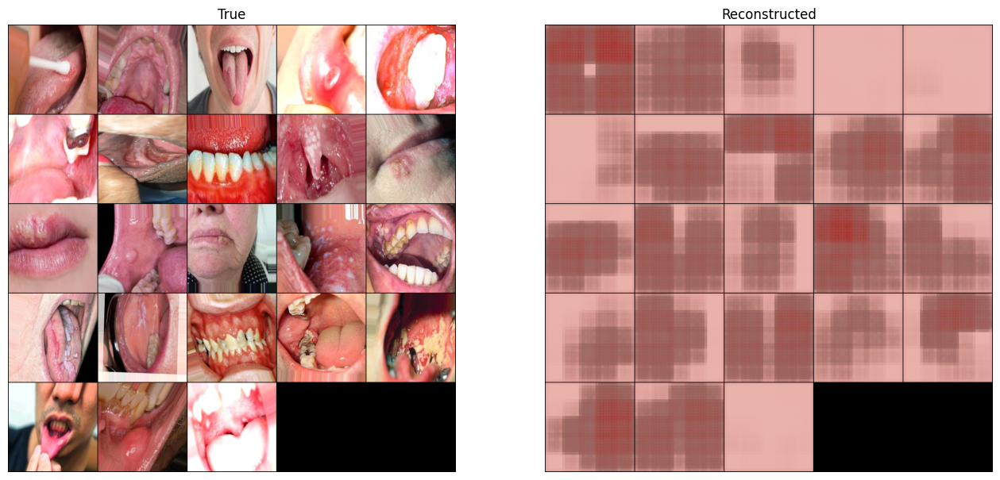

Epoch 1


100%|██████████| 41/41 [00:18<00:00,  2.27it/s]


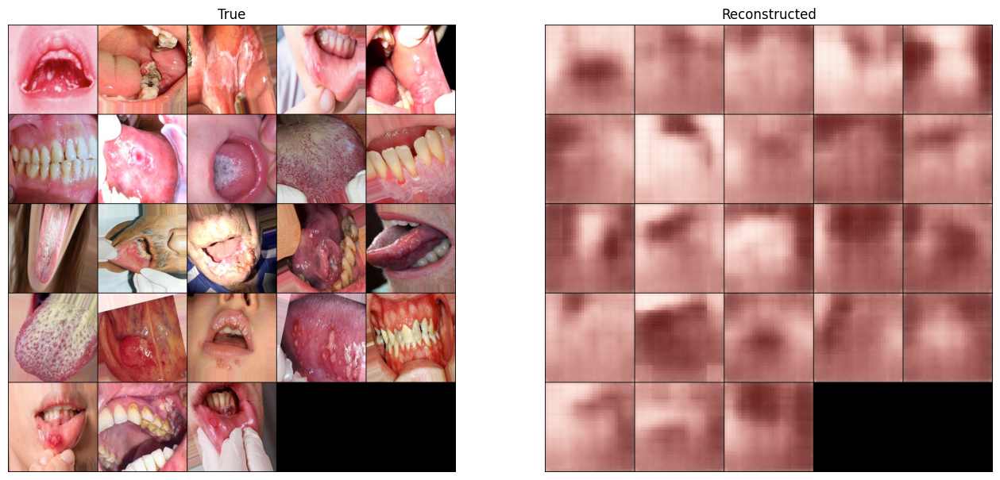

Epoch 2


100%|██████████| 41/41 [00:17<00:00,  2.31it/s]


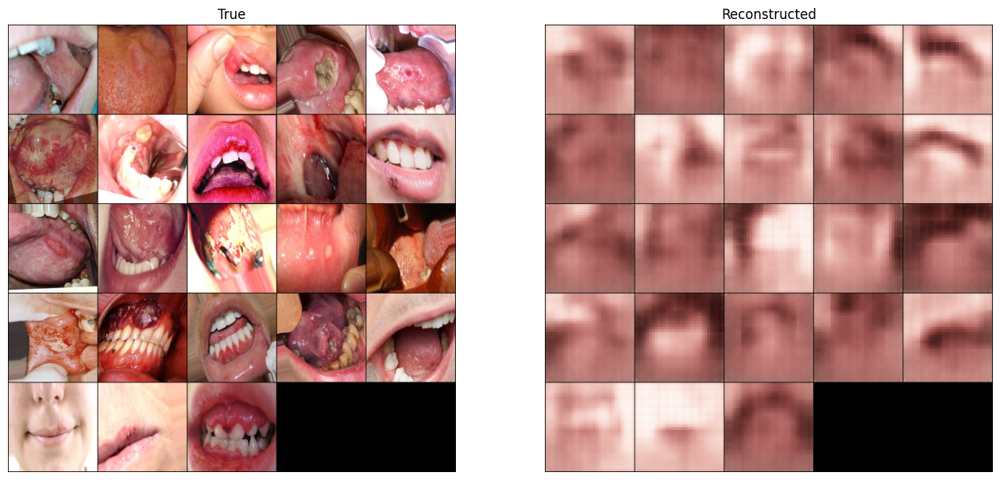

Epoch 3


100%|██████████| 41/41 [00:17<00:00,  2.29it/s]


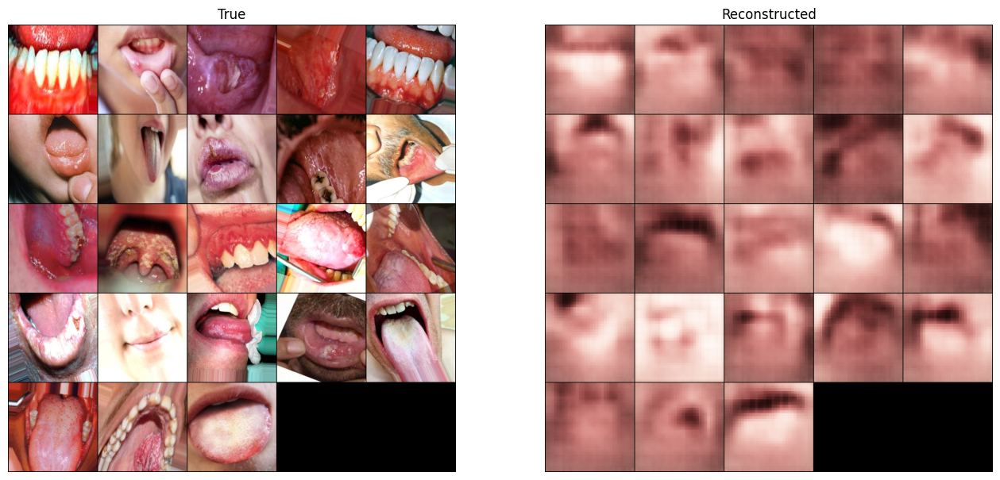

Epoch 4


100%|██████████| 41/41 [00:17<00:00,  2.33it/s]


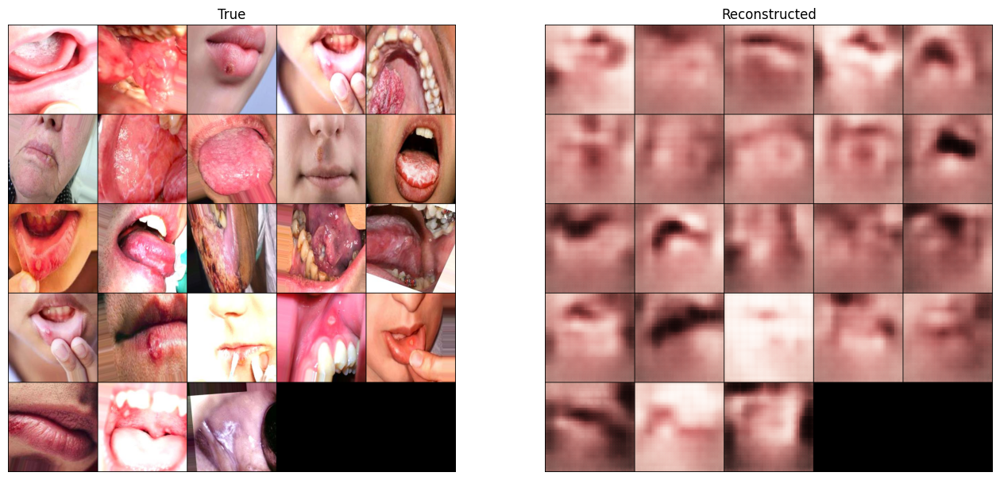

Epoch 5


100%|██████████| 41/41 [00:17<00:00,  2.36it/s]


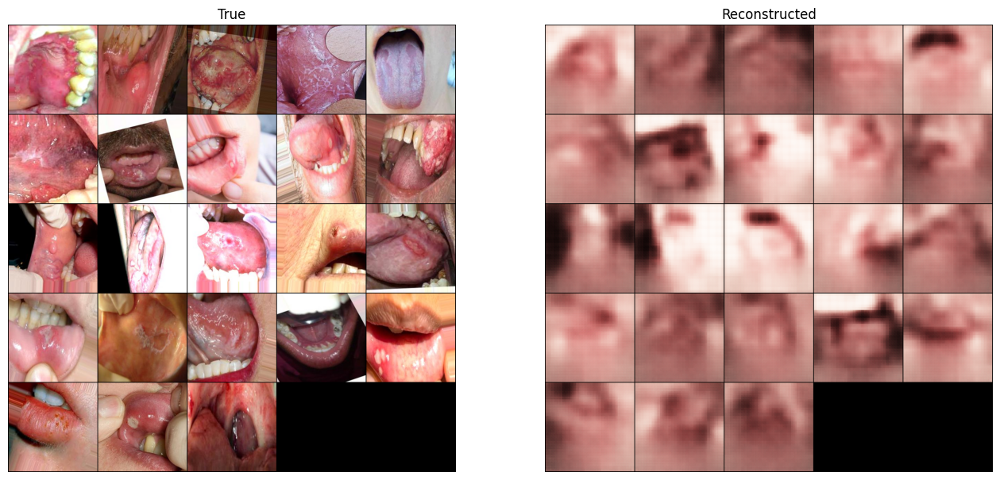

Epoch 6


100%|██████████| 41/41 [00:17<00:00,  2.36it/s]


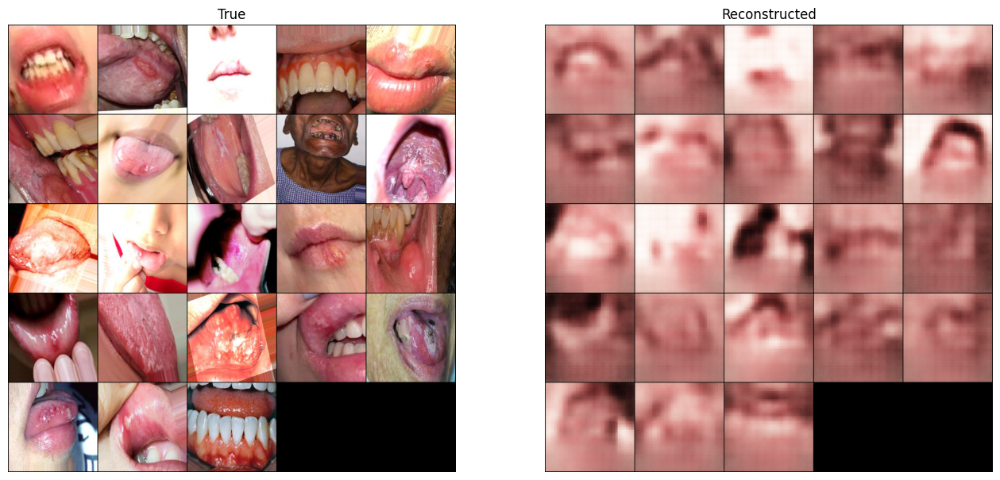

Epoch 7


100%|██████████| 41/41 [00:17<00:00,  2.35it/s]


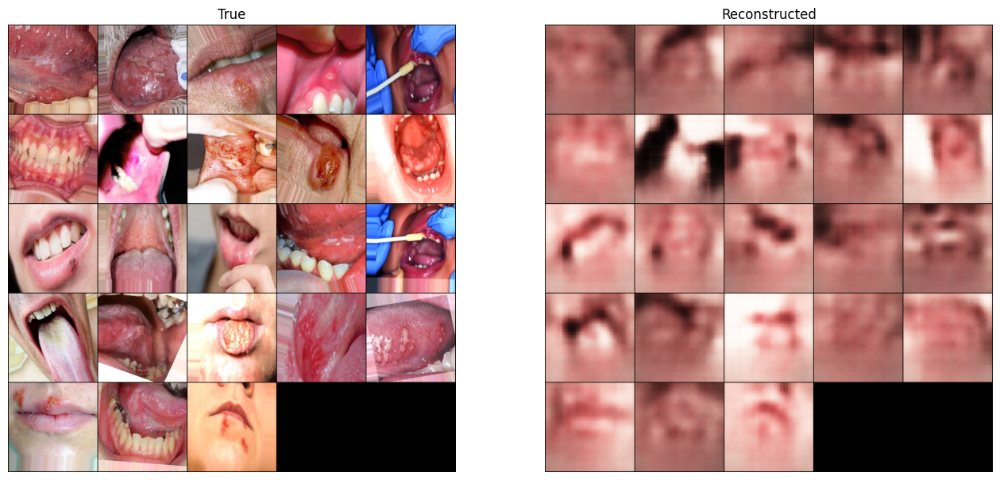

Epoch 8


100%|██████████| 41/41 [00:17<00:00,  2.33it/s]


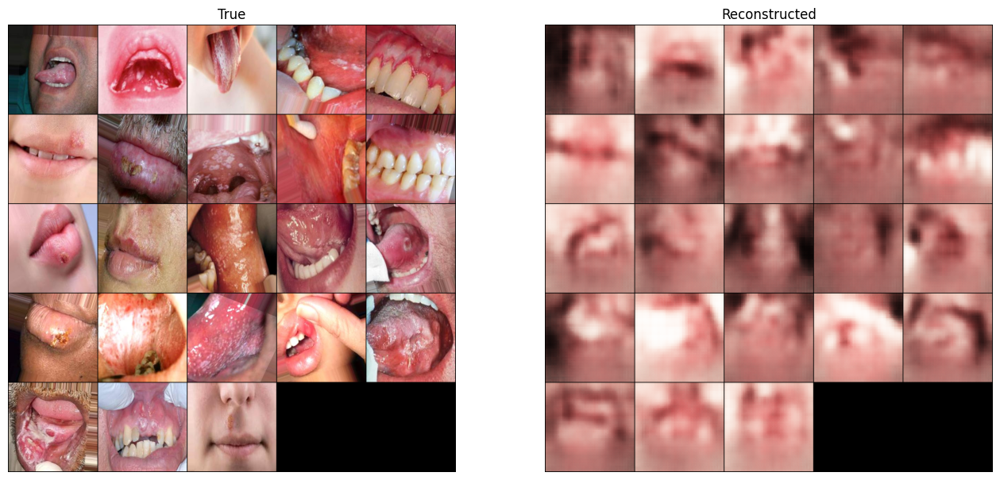

Epoch 9


100%|██████████| 41/41 [00:18<00:00,  2.26it/s]


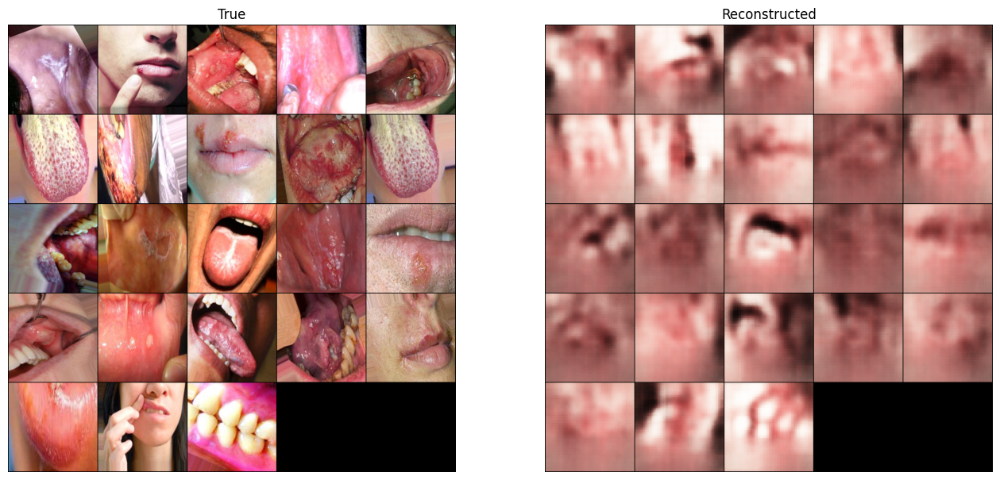

Epoch 10


100%|██████████| 41/41 [00:17<00:00,  2.33it/s]


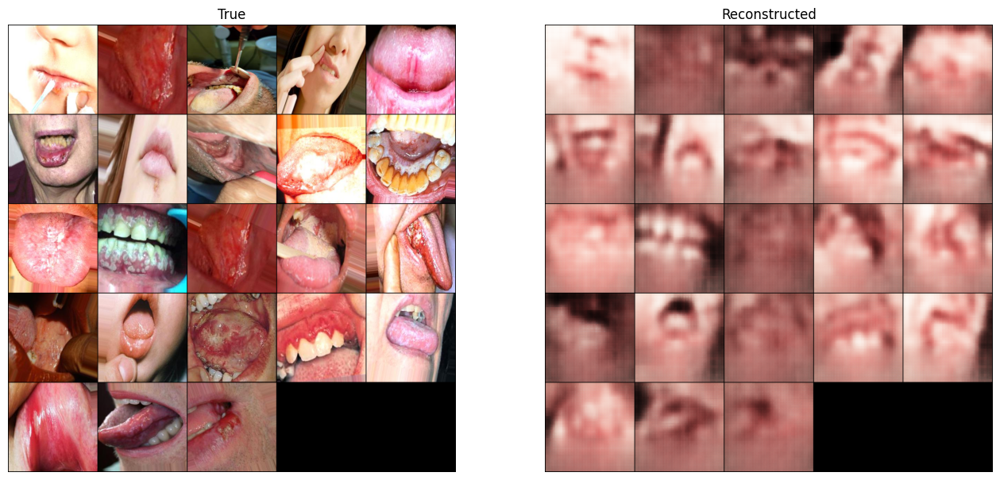

Epoch 11


100%|██████████| 41/41 [00:17<00:00,  2.34it/s]


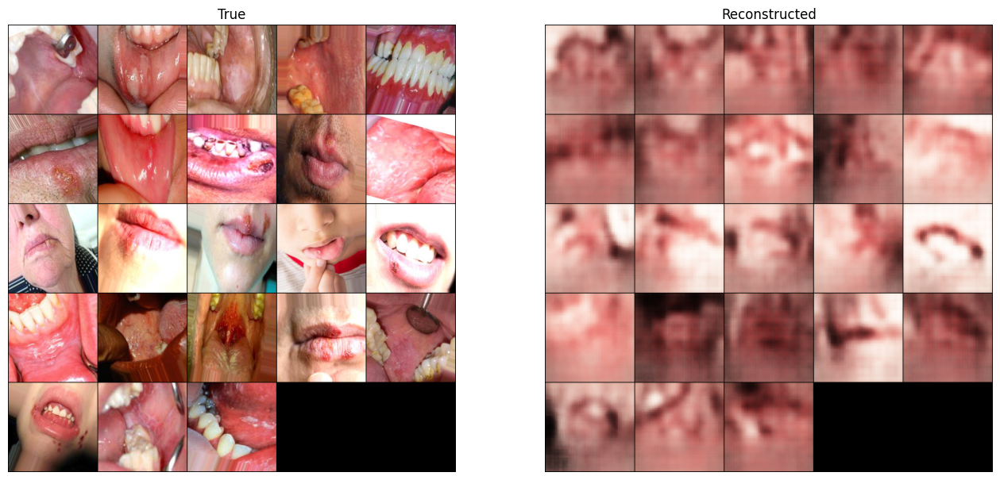

Epoch 12


100%|██████████| 41/41 [00:17<00:00,  2.32it/s]


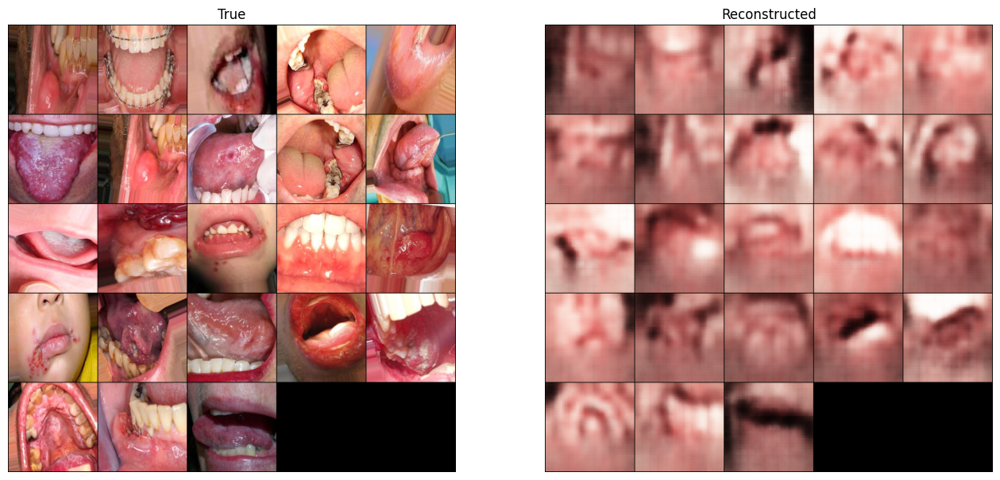

Epoch 13


100%|██████████| 41/41 [00:17<00:00,  2.36it/s]


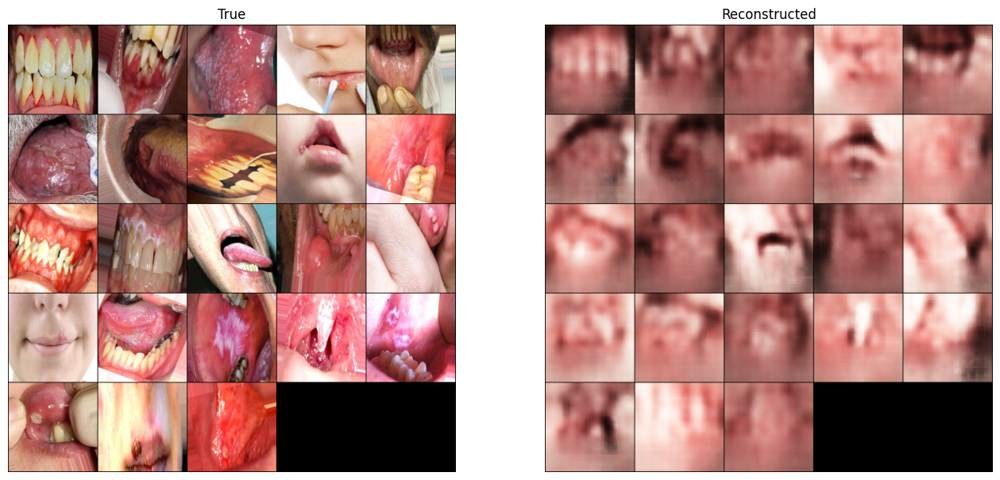

Epoch 14


100%|██████████| 41/41 [00:17<00:00,  2.31it/s]


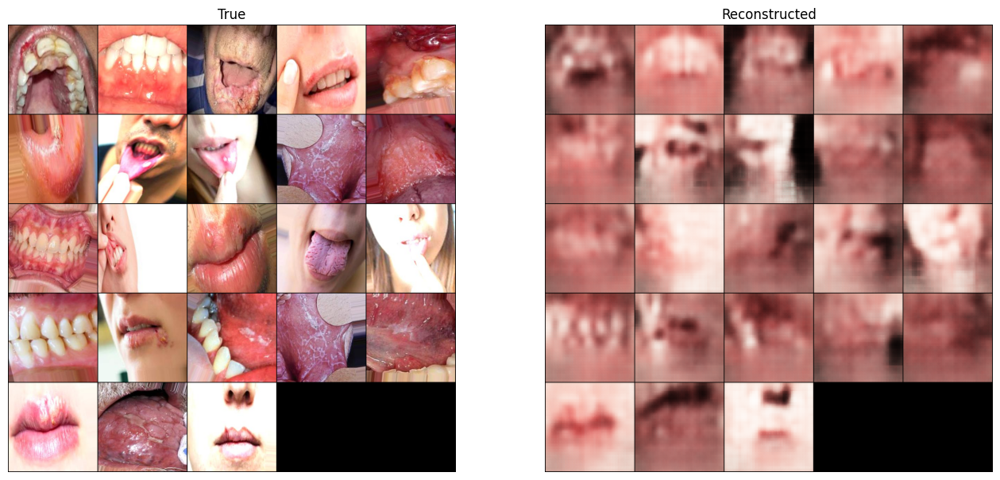

Epoch 15


100%|██████████| 41/41 [00:17<00:00,  2.28it/s]


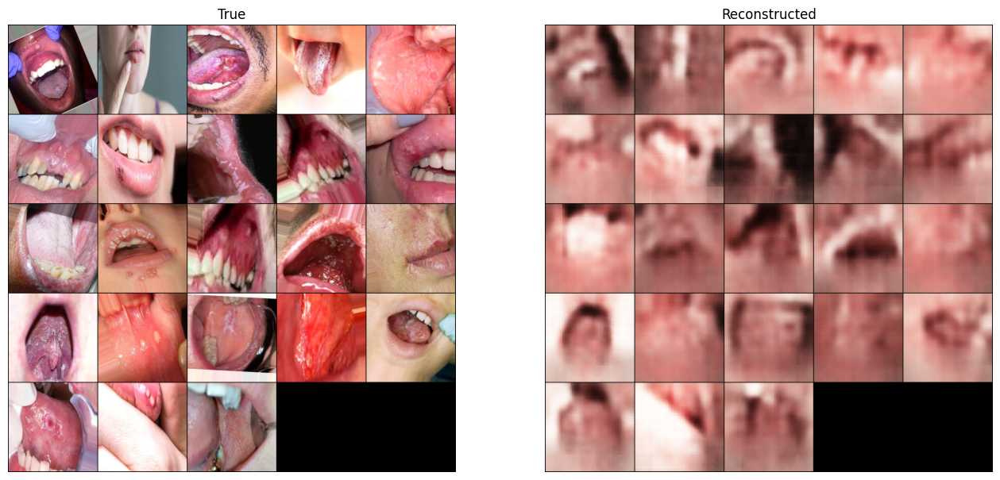

Epoch 16


100%|██████████| 41/41 [00:17<00:00,  2.32it/s]


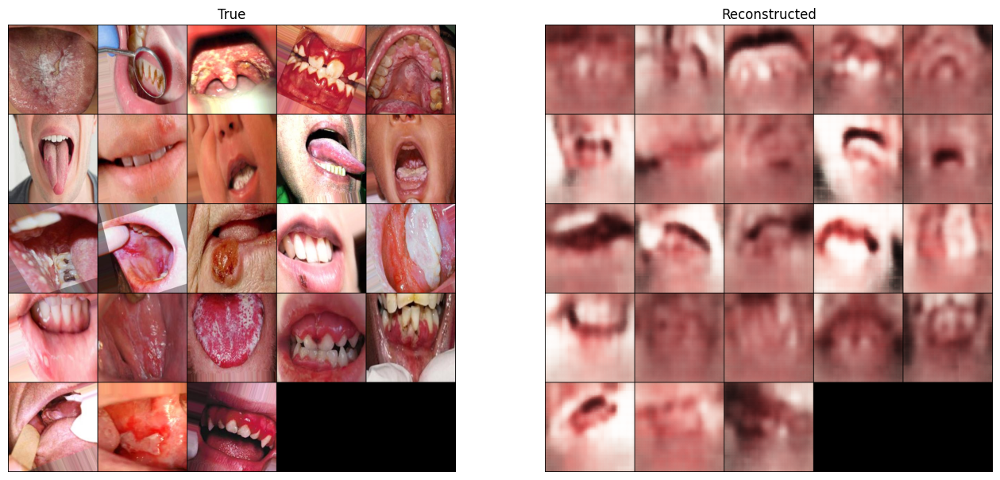

Epoch 17


100%|██████████| 41/41 [00:16<00:00,  2.50it/s]


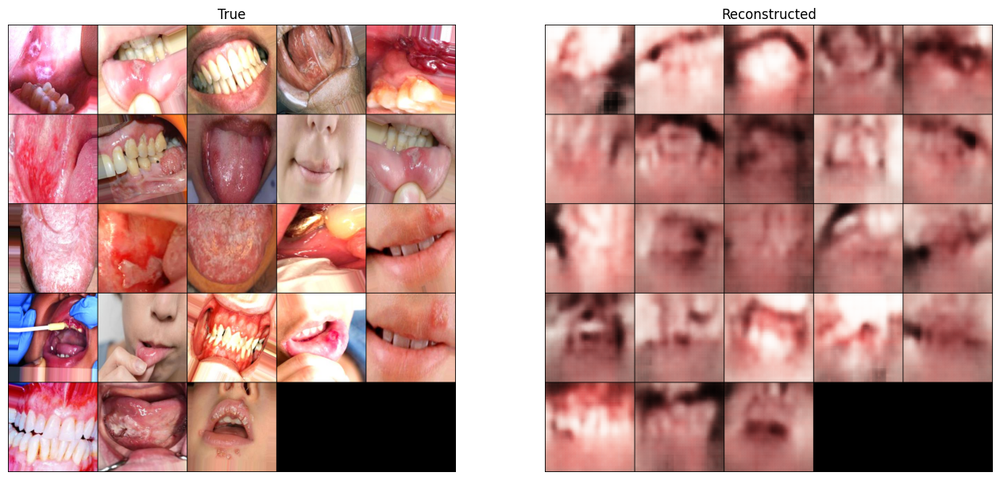

Epoch 18


100%|██████████| 41/41 [00:16<00:00,  2.51it/s]


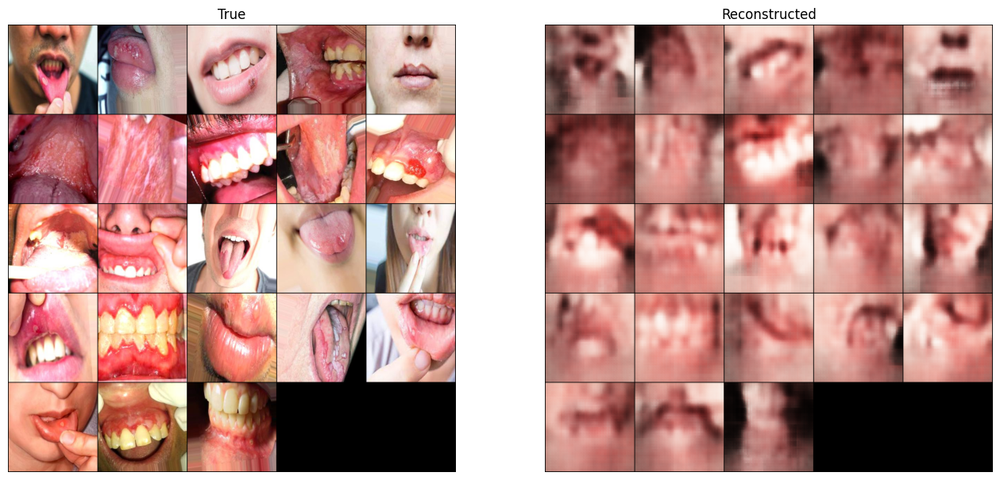

Epoch 19


100%|██████████| 41/41 [00:15<00:00,  2.57it/s]


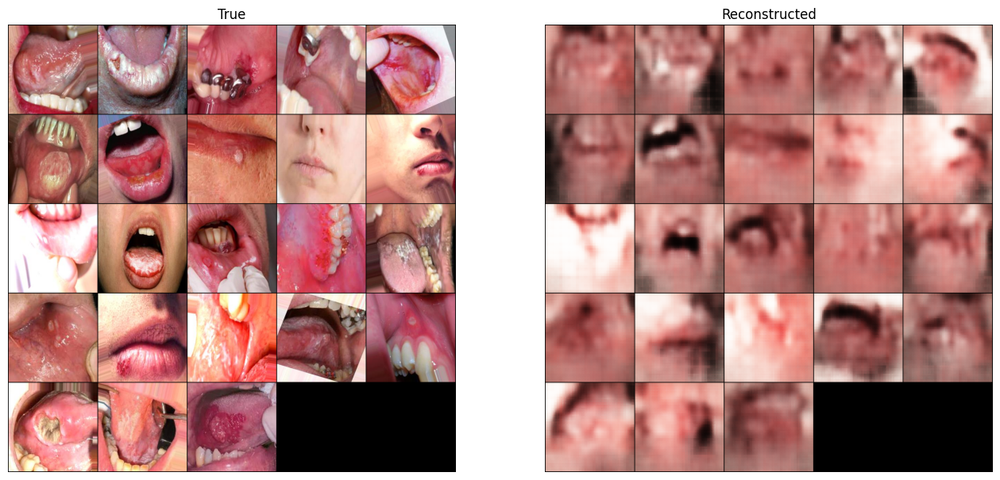

Epoch 20


100%|██████████| 41/41 [00:16<00:00,  2.51it/s]


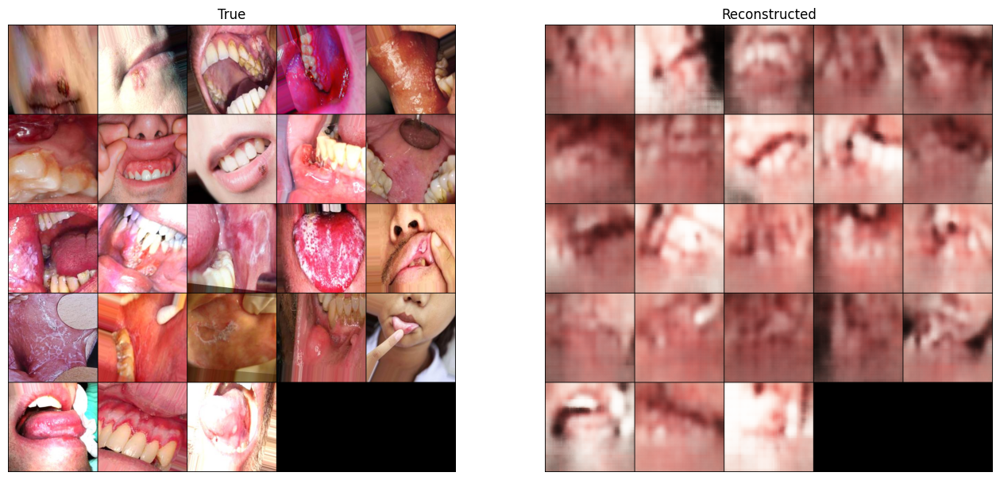

Epoch 21


100%|██████████| 41/41 [00:16<00:00,  2.53it/s]


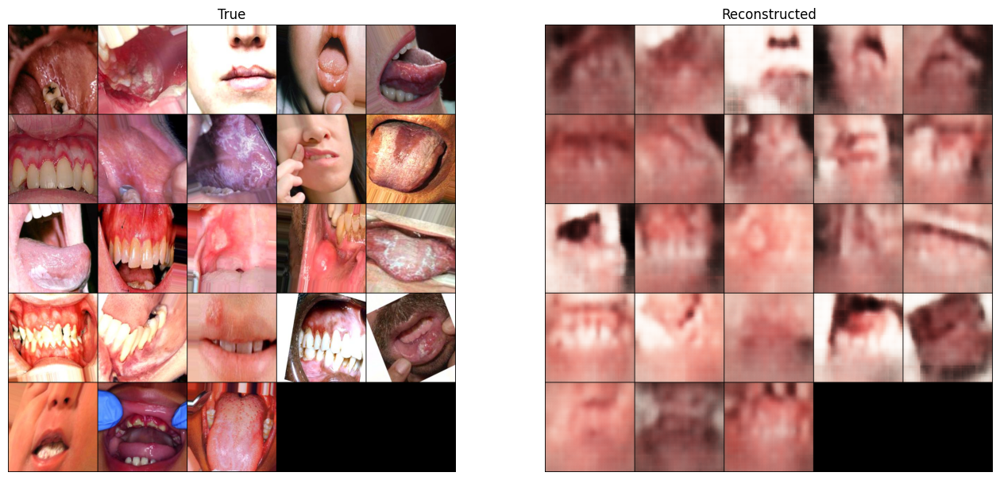

Epoch 22


100%|██████████| 41/41 [00:16<00:00,  2.45it/s]


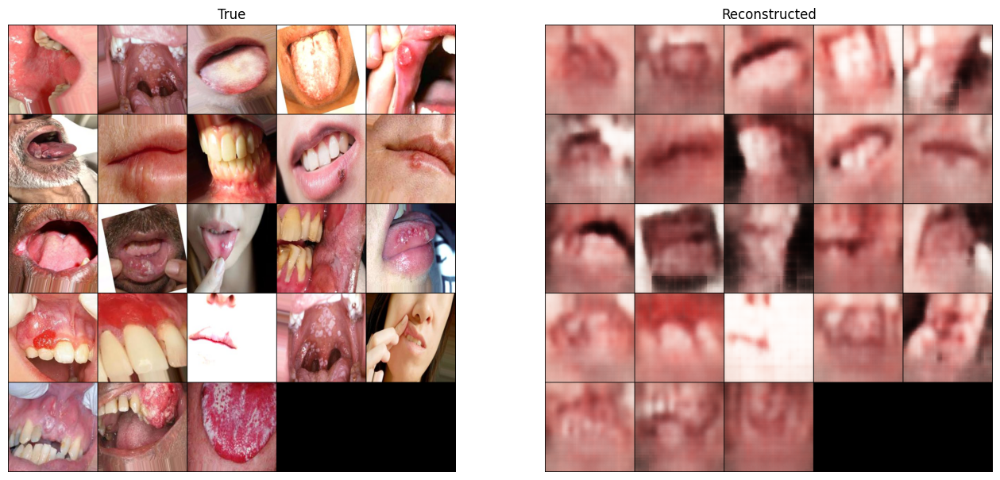

Epoch 23


100%|██████████| 41/41 [00:16<00:00,  2.50it/s]


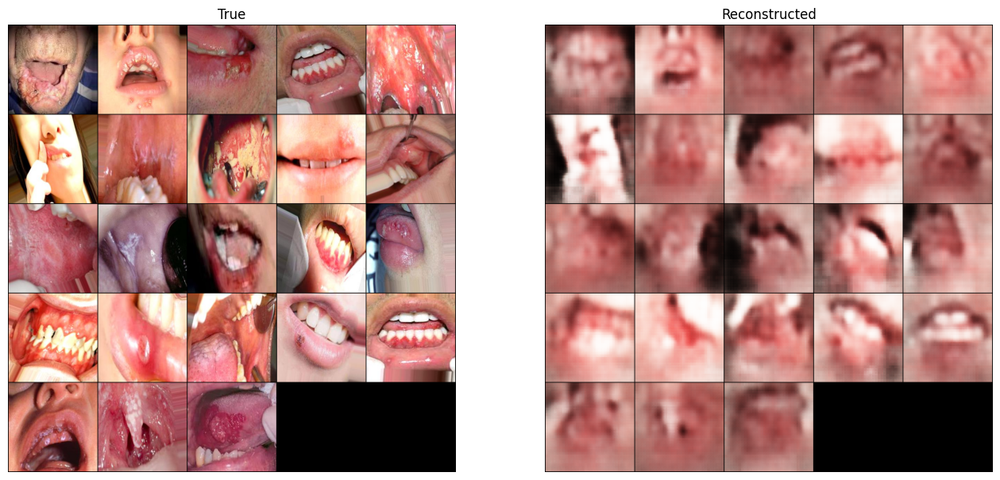

Epoch 24


100%|██████████| 41/41 [00:16<00:00,  2.44it/s]


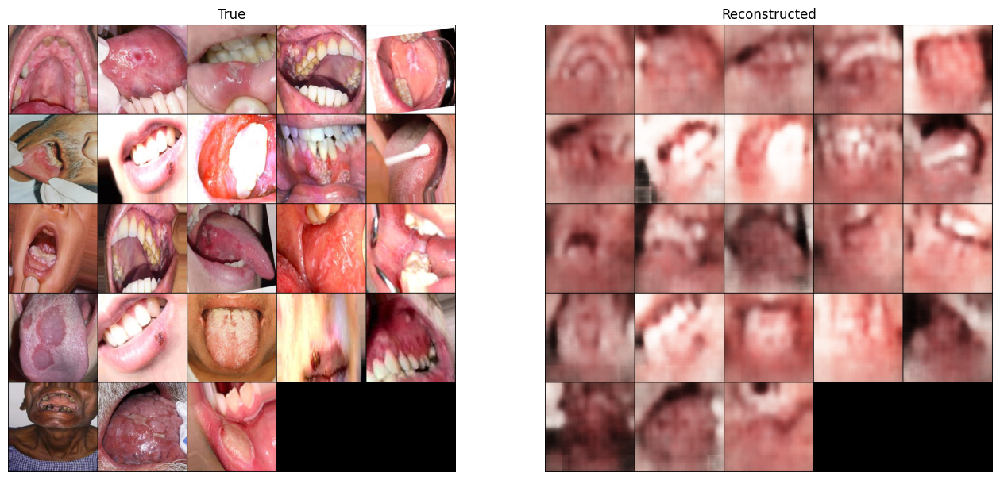

Epoch 25


100%|██████████| 41/41 [00:17<00:00,  2.38it/s]


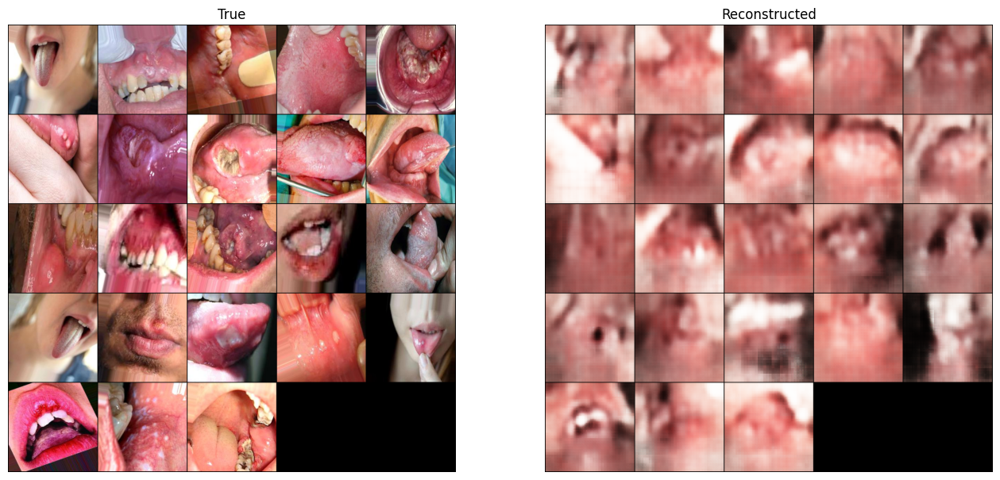

Epoch 26


100%|██████████| 41/41 [00:17<00:00,  2.34it/s]


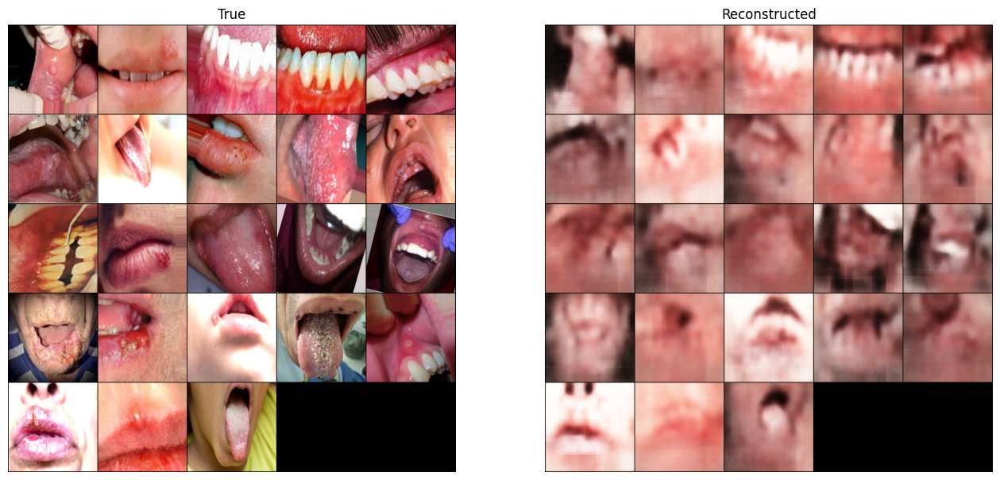

Epoch 27


100%|██████████| 41/41 [00:17<00:00,  2.29it/s]


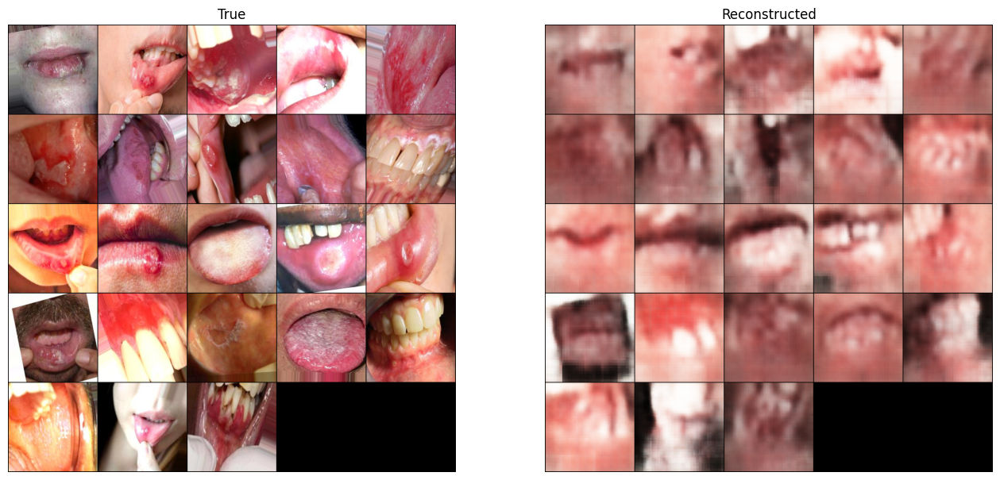

Epoch 28


100%|██████████| 41/41 [00:17<00:00,  2.28it/s]


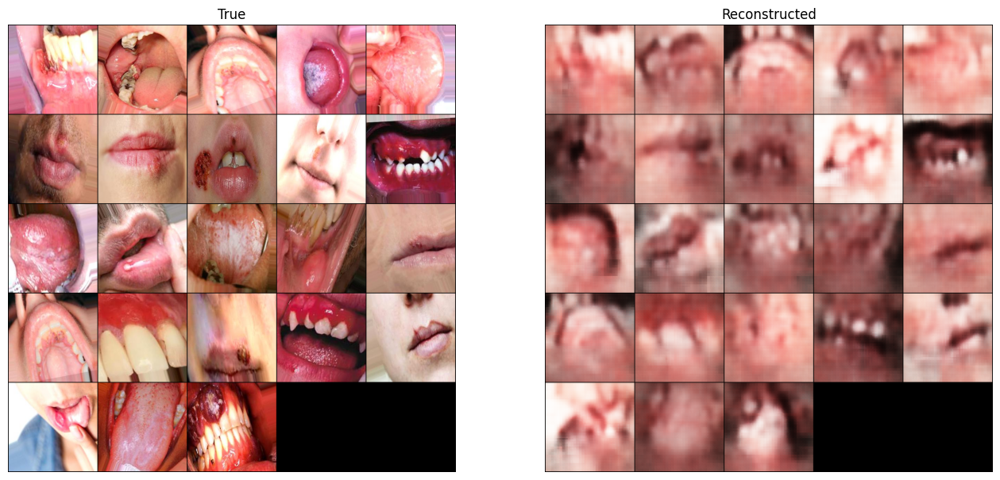

Epoch 29


100%|██████████| 41/41 [00:17<00:00,  2.30it/s]


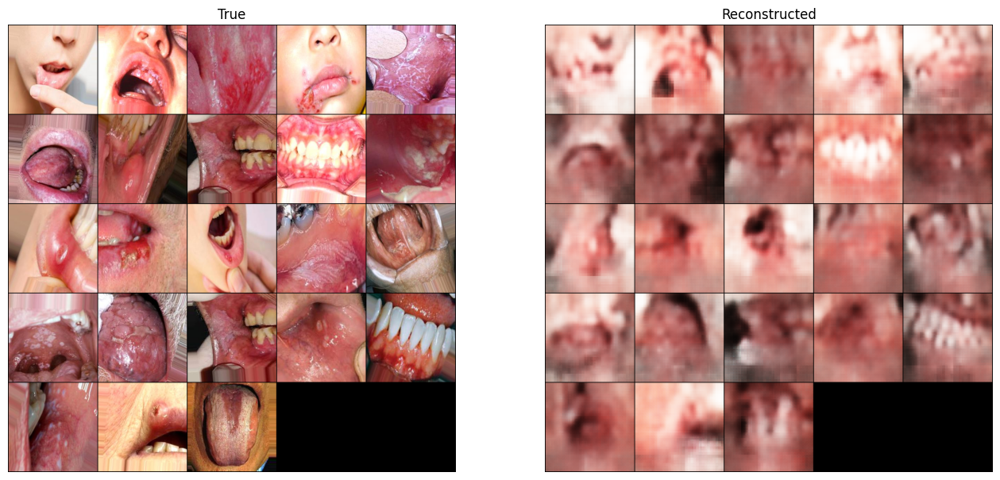

Epoch 30


100%|██████████| 41/41 [00:17<00:00,  2.30it/s]


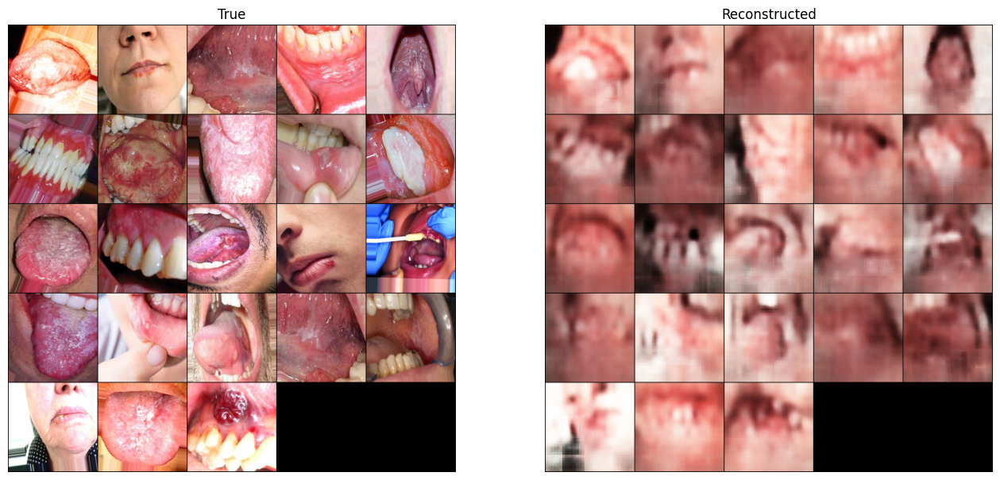

Epoch 31


100%|██████████| 41/41 [00:17<00:00,  2.33it/s]


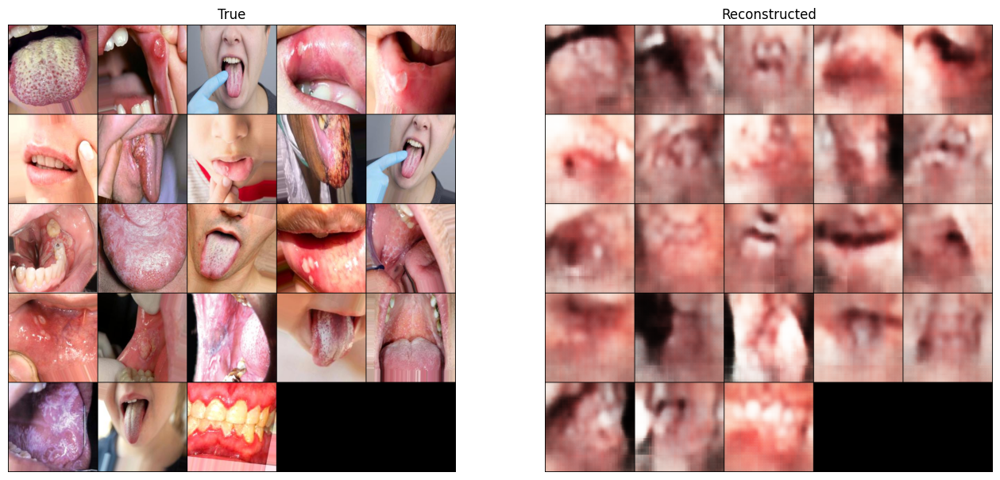

Epoch 32


100%|██████████| 41/41 [00:17<00:00,  2.34it/s]


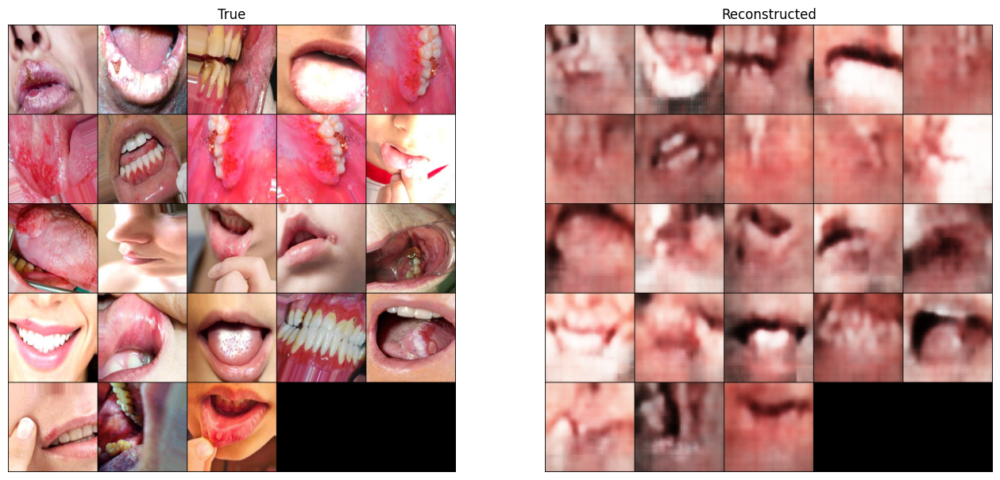

Epoch 33


100%|██████████| 41/41 [00:17<00:00,  2.29it/s]


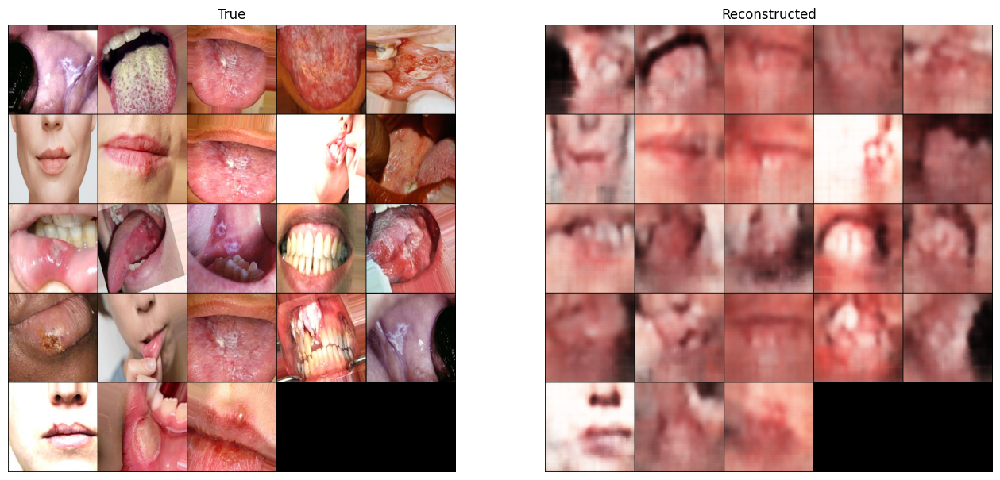

Epoch 34


100%|██████████| 41/41 [00:18<00:00,  2.25it/s]


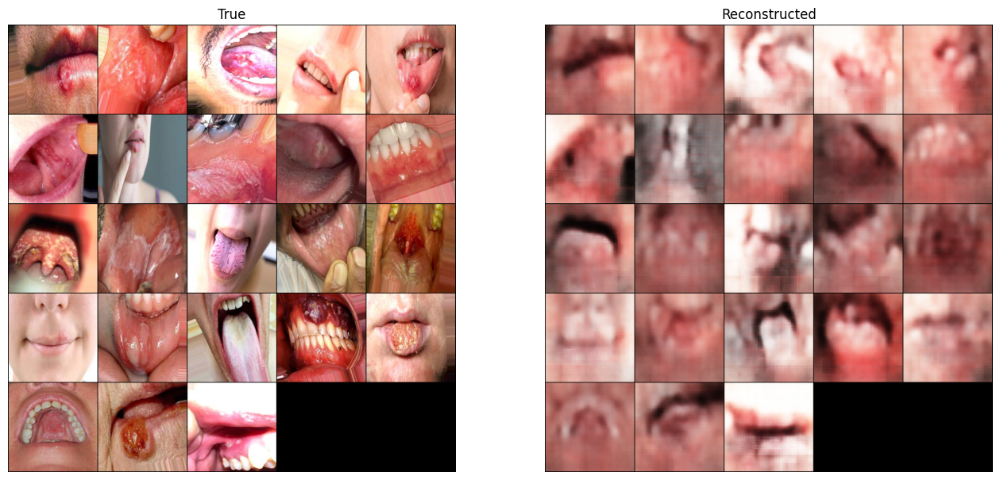

Epoch 35


100%|██████████| 41/41 [00:17<00:00,  2.29it/s]


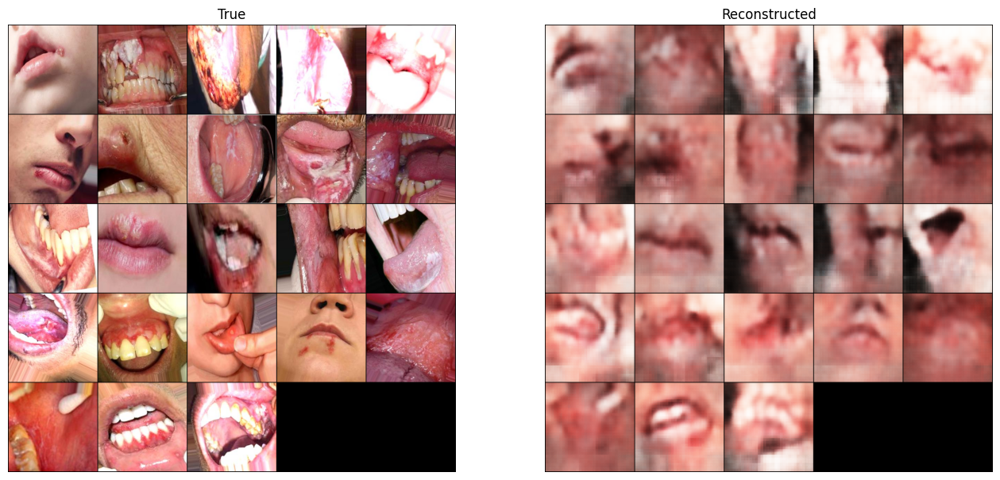

Epoch 36


 54%|█████▎    | 22/41 [00:09<00:08,  2.32it/s]

In [ ]:
plt.rcParams["figure.figsize"] = (16, 8)
device = 'cuda'
vae = VAE().to(device)
# vae=nn.DataParallel(vae)
vae_opt = torch.optim.Adam(vae.parameters(), lr=0.002)
for epoch in range(50):
    print(f"Epoch {epoch}")
    time.sleep(0.5)
    for images, _ in tqdm(train_dataloader):
#         images, _=images.cuda(non_blocking=True),_.cuda(non_blocking=True)
        images = images.to(device)
        vae_opt.zero_grad() 
        recon_images, encoding = vae(images)
        loss = reconstruction_loss(recon_images, images) + kl_divergence_loss(encoding).sum()
        loss.backward()
        vae_opt.step()
    plt.subplot(1,2,1)
    show_tensor_images(images)
    plt.title("True")
    plt.subplot(1,2,2)
    show_tensor_images(recon_images)
    plt.title("Reconstructed")
    plt.show()